## Loading Dataset :

In [224]:
original_data <- read.csv("train.csv")

In [225]:
#showing first 10 rows of the data ........
head(original_data,10)

,X,id,Gender,Customer.Type,Age,Type.of.Travel,Class,Flight.Distance,Inflight.wifi.service,Departure.Arrival.time.convenient,⋯,Inflight.entertainment,On.board.service,Leg.room.service,Baggage.handling,Checkin.service,Inflight.service,Cleanliness,Departure.Delay.in.Minutes,Arrival.Delay.in.Minutes,satisfaction
,<int>,<int>,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<chr>
1,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,⋯,5,4,3,4,4,5,5,25,18,neutral or dissatisfied
2,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,⋯,1,1,5,3,1,4,1,1,6,neutral or dissatisfied
3,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,⋯,5,4,3,4,4,4,5,0,0,satisfied
4,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,⋯,2,2,5,3,1,4,2,11,9,neutral or dissatisfied
5,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,⋯,3,3,4,4,3,3,3,0,0,satisfied
6,5,111157,Female,Loyal Customer,26,Personal Travel,Eco,1180,3,4,⋯,1,3,4,4,4,4,1,0,0,neutral or dissatisfied
7,6,82113,Male,Loyal Customer,47,Personal Travel,Eco,1276,2,4,⋯,2,3,3,4,3,5,2,9,23,neutral or dissatisfied
8,7,96462,Female,Loyal Customer,52,Business travel,Business,2035,4,3,⋯,5,5,5,5,4,5,4,4,0,satisfied
9,8,79485,Female,Loyal Customer,41,Business travel,Business,853,1,2,⋯,1,1,2,1,4,1,2,0,0,neutral or dissatisfied


In [226]:
#dimension of the data .........
dim(original_data)

[1] 103904     25

## Data Pre-processing :

In [227]:
#considering only required variables .........................
variables_of_interest <- original_data[,-c(1,2)]
head(variables_of_interest,10)

,Gender,Customer.Type,Age,Type.of.Travel,Class,Flight.Distance,Inflight.wifi.service,Departure.Arrival.time.convenient,Ease.of.Online.booking,Gate.location,⋯,Inflight.entertainment,On.board.service,Leg.room.service,Baggage.handling,Checkin.service,Inflight.service,Cleanliness,Departure.Delay.in.Minutes,Arrival.Delay.in.Minutes,satisfaction
,<chr>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<chr>
1,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,⋯,5,4,3,4,4,5,5,25,18,neutral or dissatisfied
2,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,⋯,1,1,5,3,1,4,1,1,6,neutral or dissatisfied
3,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,⋯,5,4,3,4,4,4,5,0,0,satisfied
4,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,⋯,2,2,5,3,1,4,2,11,9,neutral or dissatisfied
5,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,⋯,3,3,4,4,3,3,3,0,0,satisfied
6,Female,Loyal Customer,26,Personal Travel,Eco,1180,3,4,2,1,⋯,1,3,4,4,4,4,1,0,0,neutral or dissatisfied
7,Male,Loyal Customer,47,Personal Travel,Eco,1276,2,4,2,3,⋯,2,3,3,4,3,5,2,9,23,neutral or dissatisfied
8,Female,Loyal Customer,52,Business travel,Business,2035,4,3,4,4,⋯,5,5,5,5,4,5,4,4,0,satisfied
9,Female,Loyal Customer,41,Business travel,Business,853,1,2,2,2,⋯,1,1,2,1,4,1,2,0,0,neutral or dissatisfied


In [228]:
#structure of the dataset ......................
str(variables_of_interest)

'data.frame':	103904 obs. of  23 variables:
 $ Gender                           : chr  "Male" "Male" "Female" "Female" ...
 $ Customer.Type                    : chr  "Loyal Customer" "disloyal Customer" "Loyal Customer" "Loyal Customer" ...
 $ Age                              : int  13 25 26 25 61 26 47 52 41 20 ...
 $ Type.of.Travel                   : chr  "Personal Travel" "Business travel" "Business travel" "Business travel" ...
 $ Class                            : chr  "Eco Plus" "Business" "Business" "Business" ...
 $ Flight.Distance                  : int  460 235 1142 562 214 1180 1276 2035 853 1061 ...
 $ Inflight.wifi.service            : int  3 3 2 2 3 3 2 4 1 3 ...
 $ Departure.Arrival.time.convenient: int  4 2 2 5 3 4 4 3 2 3 ...
 $ Ease.of.Online.booking           : int  3 3 2 5 3 2 2 4 2 3 ...
 $ Gate.location                    : int  1 3 2 5 3 1 3 4 2 4 ...
 $ Food.and.drink                   : int  5 1 5 2 4 1 2 5 4 2 ...
 $ Online.boarding                  : int  3 

In [229]:
#summary statistics of the dataset .......................
summary(variables_of_interest)

    Gender          Customer.Type           Age        Type.of.Travel    
 Length:103904      Length:103904      Min.   : 7.00   Length:103904     
 Class :character   Class :character   1st Qu.:27.00   Class :character  
 Mode  :character   Mode  :character   Median :40.00   Mode  :character  
                                       Mean   :39.38                     
                                       3rd Qu.:51.00                     
                                       Max.   :85.00                     
                                                                         
    Class           Flight.Distance Inflight.wifi.service
 Length:103904      Min.   :  31    Min.   :0.00         
 Class :character   1st Qu.: 414    1st Qu.:2.00         
 Mode  :character   Median : 843    Median :3.00         
                    Mean   :1189    Mean   :2.73         
                    3rd Qu.:1743    3rd Qu.:4.00         
                    Max.   :4983    Max.   :5.00         
  

In [230]:
#locating the missing values ................

table(is.na(variables_of_interest))

apply(is.na(variables_of_interest), 2, which) 


  FALSE    TRUE 
2389482     310 

$Gender
integer(0)

$Customer.Type
integer(0)

$Age
integer(0)

$Type.of.Travel
integer(0)

$Class
integer(0)

$Flight.Distance
integer(0)

$Inflight.wifi.service
integer(0)

$Departure.Arrival.time.convenient
integer(0)

$Ease.of.Online.booking
integer(0)

$Gate.location
integer(0)

$Food.and.drink
integer(0)

$Online.boarding
integer(0)

$Seat.comfort
integer(0)

$Inflight.entertainment
integer(0)

$On.board.service
integer(0)

$Leg.room.service
integer(0)

$Baggage.handling
integer(0)

$Checkin.service
integer(0)

$Inflight.service
integer(0)

$Cleanliness
integer(0)

$Departure.Delay.in.Minutes
integer(0)

$Arrival.Delay.in.Minutes
  [1]    214   1125   1530   2005   2109   2486   2631   3622   4042   4491
 [11]   4589   4689   4898   5296   5297   5497   6948   7226   8036   8422
 [21]   8934   9061   9482   9532   9552   9941  10635  10881  12037  12690
 [31]  12809  13502  14186  14302  15224  15372  15684  15861  16133  16330
 [41]  16504  16882  17235  17809  18430  18621  18725  18797  18872  19499
 [51]  19972  20050  20666  21454  21795  22203  22841  22940  22987  23034
 [61]  23506  24181  26132  26311  26339  26606  26914  27136  27239  27262
 [71]  27280  27619  27820  27905  27917  27993  28353  28495  28960  29487
 [81]  29919  30505  30530  32198  32559  32865  32917  33057  33060  33272
 [91]  33471  33871  33938  34141  34465  34678  34728  34838  34842  35249
[101]  35268  35272  35310  35341  35502  35893  35960  36065  36320  36536
[111]  37096  37576  37756  37892  38611  38678  39077  39292  39835  40100
[121]  40344  40423  40628  41080  41294  41981  42301  42439  43052  43247
[131]  43816  43830  44058  44095  44231  44327  45065  45082  45246  45308
[141]  45871  46088  46296  46564  46759  46817  46944  47062  47111  47369
[151]  47627  47637  47809  48517  48641  49755  50585  50978  51881  52127
[161]  52240  52569  52677  52879  53402  54019  54415  54938  55134  55368
[171]  55430  56040  56126  56150  56714  58176  58678  58792  59472  59680
[181]  60016  60368  60416  60434  61345  62433  62505  62607  62970  63377
[191]  63383  63707  63778  63899  64798  66423  66429  66829  66939  67343
[201]  67714  67844  67997  68113  68399  68617  68712  68914  69041  69393
[211]  69608  70168  70259  70295  70649  70939  70941  71051  71231  71558
[221]  73170  74690  75046  75335  76292  76372  76867  76956  77122  77283
[231]  78117  78236  78238  78700  78729  78930  78965  79014  80968  81063
[241]  81076  81109  81347  81455  82626  83396  83759  83881  84040  84486
[251]  84638  84711  84820  85649  85690  85739  85758  85808  85888  85950
[261]  86117  86469  86476  86907  87017  87031  87262  87907  88554  88854
[271]  89063  90444  90749  91580  91679  91901  92052  92779  93141  93188
[281]  93271  93328  93396  93875  94281  94625  94725  94760  95563  96094
[291]  96356  96947  97244  97394  97823  97916  98447  98637  98947  99815
[301] 100427 100683 100963 101243 101533 102068 102385 102553 102961 103541

$satisfaction
integer(0)

In [66]:
#changing all the 'character' variables to 'factor' ........................

variables_of_interest[sapply(variables_of_interest, is.character)] <-                        
      lapply(variables_of_interest[sapply(variables_of_interest, is.character)], as.factor) 

str(variables_of_interest)

'data.frame':	103904 obs. of  23 variables:
 $ Gender                           : Factor w/ 2 levels "Female","Male": 2 2 1 1 2 1 2 1 1 2 ...
 $ Customer.Type                    : Factor w/ 2 levels "Loyal Customer",..: 1 2 1 1 1 1 1 1 1 2 ...
 $ Age                              : int  13 25 26 25 61 26 47 52 41 20 ...
 $ Type.of.Travel                   : Factor w/ 2 levels "Business travel",..: 2 1 1 1 1 2 2 1 1 1 ...
 $ Class                            : Factor w/ 3 levels "Business","Eco",..: 3 1 1 1 1 2 2 1 1 2 ...
 $ Flight.Distance                  : int  460 235 1142 562 214 1180 1276 2035 853 1061 ...
 $ Inflight.wifi.service            : int  3 3 2 2 3 3 2 4 1 3 ...
 $ Departure.Arrival.time.convenient: int  4 2 2 5 3 4 4 3 2 3 ...
 $ Ease.of.Online.booking           : int  3 3 2 5 3 2 2 4 2 3 ...
 $ Gate.location                    : int  1 3 2 5 3 1 3 4 2 4 ...
 $ Food.and.drink                   : int  5 1 5 2 4 1 2 5 4 2 ...
 $ Online.boarding                  : int  3 3 

In [69]:
#changing some 'integer' variables to factors ..........................

for (i in c(7:20)) {
variables_of_interest[,i] <- as.factor(variables_of_interest[,i])    
}

head(variables_of_interest,10)


,Gender,Customer.Type,Age,Type.of.Travel,Class,Flight.Distance,Inflight.wifi.service,Departure.Arrival.time.convenient,Ease.of.Online.booking,Gate.location,⋯,Inflight.entertainment,On.board.service,Leg.room.service,Baggage.handling,Checkin.service,Inflight.service,Cleanliness,Departure.Delay.in.Minutes,Arrival.Delay.in.Minutes,satisfaction
,<fct>,<fct>,<int>,<fct>,<fct>,<int>,<fct>,<fct>,<fct>,<fct>,⋯,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<int>,<dbl>,<fct>
1,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,⋯,5,4,3,4,4,5,5,25,18,neutral or dissatisfied
2,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,⋯,1,1,5,3,1,4,1,1,6,neutral or dissatisfied
3,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,⋯,5,4,3,4,4,4,5,0,0,satisfied
4,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,⋯,2,2,5,3,1,4,2,11,9,neutral or dissatisfied
5,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,⋯,3,3,4,4,3,3,3,0,0,satisfied
6,Female,Loyal Customer,26,Personal Travel,Eco,1180,3,4,2,1,⋯,1,3,4,4,4,4,1,0,0,neutral or dissatisfied
7,Male,Loyal Customer,47,Personal Travel,Eco,1276,2,4,2,3,⋯,2,3,3,4,3,5,2,9,23,neutral or dissatisfied
8,Female,Loyal Customer,52,Business travel,Business,2035,4,3,4,4,⋯,5,5,5,5,4,5,4,4,0,satisfied
9,Female,Loyal Customer,41,Business travel,Business,853,1,2,2,2,⋯,1,1,2,1,4,1,2,0,0,neutral or dissatisfied


In [86]:
#impution NA values using the median................... 

median_arrival_delay <- median(variables_of_interest$Arrival.Delay.in.Minutes, na.rm = TRUE)
median_arrival_delay

variables_of_interest[is.na(variables_of_interest$Arrival.Delay.in.Minutes),
                      "Arrival.Delay.in.Minutes"] <- median_arrival_delay

[1] 0


  FALSE 
2389792 

In [106]:
#checking the proportionality of 'satisfied' and 'nutral or dissatisfied' i the dataset ............
library("tidyverse")

variables_of_interest %>% 
    group_by(satisfaction) %>% 
    summarise(frequency = n()) %>% 
    mutate(proportion = frequency/nrow(variables_of_interest))

satisfaction,frequency,proportion
<fct>,<int>,<dbl>
neutral or dissatisfied,58879,0.5666673
satisfied,45025,0.4333327


In [90]:
#loading requried libraries ...............
library('ggplot2')
library('randomForest')
library('cowplot')


In [99]:
#splitting train data and test data ..........................

library('caTools')
set.seed(99) 
sample = sample.split(variables_of_interest$satisfaction, SplitRatio = .80)
train = subset(variables_of_interest, sample == TRUE)
test  = subset(variables_of_interest, sample == FALSE)
# head(train,10)
# head(test,10)

## Random Forest Model :

In [104]:
#random forest model ...........................

rf_model <- randomForest(satisfaction ~., data = train, importance = TRUE)
rf_model


Call:
 randomForest(formula = satisfaction ~ ., data = train, importance = TRUE) 
               Type of random forest: classification
                     Number of trees: 500
No. of variables tried at each split: 4

        OOB estimate of  error rate: 3.76%
Confusion matrix:
                        neutral or dissatisfied satisfied class.error
neutral or dissatisfied                   46170       933  0.01980766
satisfied                                  2193     33827  0.06088284

In [116]:
head(rf_model$err.rate)
dim(oob_error_data)

OOB,neutral or dissatisfied,satisfied
0.06987669,0.06157381,0.08079130
0.06894963,0.06026352,0.08031999
0.07232477,0.06049852,0.08774007
0.07000786,0.05604601,0.08828287
0.06653571,0.05159966,0.08604536
0.06467534,0.04921157,0.08488245


[1] 1500    3

In [115]:
#OOB error rate vs tree ..............................

oob_error_data <- data.frame(
    Trees = rep(1:nrow(rf_model$err.rate),times = 3),
    Type = rep(c("OOB","Neutral or Dissatisfied","Satisfied"),each = nrow(rf_model$err.rate)),
    Error = c(rf_model$err.rate[,"OOB"], 
              rf_model$err.rate[,"neutral or dissatisfied"], 
              rf_model$err.rate[,"satisfied"]))
head(oob_error_data)
dim(oob_error_data)

,Trees,Type,Error
,<int>,<chr>,<dbl>
1,1,OOB,0.06987669
2,2,OOB,0.06894963
3,3,OOB,0.07232477
4,4,OOB,0.07000786
5,5,OOB,0.06653571
6,6,OOB,0.06467534


[1] 1500    3

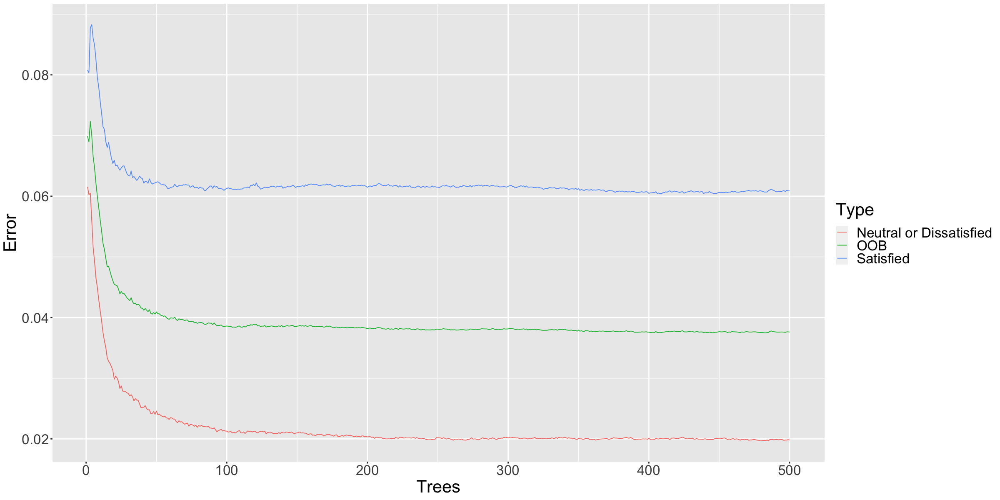

In [130]:
options(repr.plot.width = 20, repr.plot.height = 10)
ggplot(data = oob_error_data, aes(x = Trees, y = Error))+
    geom_line(aes(color = Type))+
    theme(text = element_text(size = 25), element_line(size = 0.8))

In [146]:
#varifying whether 500 trees are optimum number of trees for our random forest model or not ...............

rf_model_2 <- randomForest(satisfaction ~., data = train, ntree = 1000, importance = TRUE)
rf_model_2




Call:
 randomForest(formula = satisfaction ~ ., data = train, ntree = 1000,      importance = TRUE) 
               Type of random forest: classification
                     Number of trees: 1000
No. of variables tried at each split: 4

        OOB estimate of  error rate: 3.76%
Confusion matrix:
                        neutral or dissatisfied satisfied class.error
neutral or dissatisfied                   46132       971  0.02061440
satisfied                                  2156     33864  0.05985564

In [145]:
#varifying whether 4 splits at each node is optimum or not ..................

# Errors <- vector(length = 10)
# for (i in 1:10){
#     temp_model <- randomForest(satisfaction ~., data = train, mtry = i, ntree = 500)
#     Errors[i] <- temp_model$err.rate[nrow(temp_model$err.rate),1] 
# }
Errors

[1] 0.06256993 0.04292434 0.03915884 0.03765504 0.03687307 0.03613922
 [7] 0.03595876 0.03588658 0.03550161 0.03534521

In [157]:
#random forest on test data ...............

rf_model_test <- randomForest(satisfaction ~., data = test, ntree = 500, importance = TRUE)

In [158]:
#predictions on testing dataset .........................................

rf_predictions <- predict(rf_model_test)
table(rf_predictions)

rf_predictions
neutral or dissatisfied               satisfied 
                  12077                    8704 

In [195]:
#confusion matrix and model accuracy ...............

library("caret")
confusion_matrix_test <- confusionMatrix(predict(rf_model_test), test$satisfaction, positive = "satisfied")
confusion_matrix_test

Confusion Matrix and Statistics

                         Reference
Prediction                neutral or dissatisfied satisfied
  neutral or dissatisfied                   11443       634
  satisfied                                   333      8371
                                          
               Accuracy : 0.9535          
                 95% CI : (0.9505, 0.9563)
    No Information Rate : 0.5667          
    P-Value [Acc > NIR] : < 2.2e-16       
                                          
                  Kappa : 0.9049          
                                          
 Mcnemar's Test P-Value : < 2.2e-16       
                                          
            Sensitivity : 0.9296          
            Specificity : 0.9717          
         Pos Pred Value : 0.9617          
         Neg Pred Value : 0.9475          
             Prevalence : 0.4333          
         Detection Rate : 0.4028          
   Detection Prevalence : 0.4188          
      Balanced Accura

Warning message in plot_confusion_matrix(table_test):
“'ggimage' is missing. Will not plot arrows and zero-shading.”
Warning message in plot_confusion_matrix(table_test):
“'rsvg' is missing. Will not plot arrows and zero-shading.”
Warning message:
“Ignoring unknown parameters: linewidth”


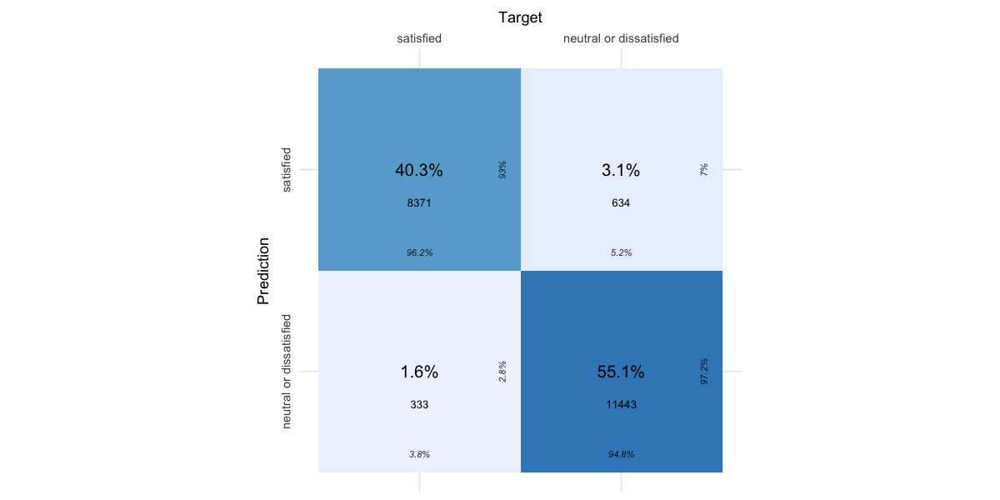

In [188]:
#ploting confusion matrix ...............

# install.packages("cvms")
library("cvms")


table_test = as_tibble(confusion_matrix_test$table)
colnames(table_test)=c('Target','Prediction','N')

options(repr.plot.width = 10, repr.plot.height = 5)
plot_confusion_matrix(table_test)


## Naive-Bayes Model :

In [240]:
# install.packages("e1071")
# library("e1071")
# nb_model = train(train[,-23],train$satisfaction,'nb',trControl=trainControl(method='cv',number=10))

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in 

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 85”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 56”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 57”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 58”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 60”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 61”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 63”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 64”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 27”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 28”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 29”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 30”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 31”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 32”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 33”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 34”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning mes

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 81”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 82”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 83”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 85”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 53”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 54”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 55”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 56”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 57”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 58”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 60”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 61”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 24”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 25”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 26”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 27”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 28”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 29”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 30”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 31”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 32”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 33”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 116”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 198”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 280”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 362”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 444”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 526”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 608”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 690”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 772”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 854”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 936”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Wa

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 78”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 79”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 80”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 81”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 82”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 83”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 85”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 50”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 51”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 52”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 53”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 54”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 55”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 56”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 57”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 58”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 21”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 22”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 23”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 24”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 25”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 26”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 27”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 28”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 29”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 30”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 113”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 195”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 277”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 359”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 441”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 523”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 605”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 687”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 769”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 851”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 933”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 75”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 76”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 77”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 78”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 79”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 80”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 81”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 82”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 83”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 47”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 48”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 49”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 50”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 51”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 52”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 53”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 54”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 55”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 56”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 139”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 221”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 303”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 385”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 467”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 549”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 631”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 713”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 795”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 877”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 959”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 21”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 22”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 23”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 24”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 25”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 26”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 109”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 191”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 273”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 355”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 437”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 519”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 601”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 683”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 765”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 847”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 929”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 75”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 76”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 77”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 78”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 79”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 162”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 244”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 326”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 408”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 490”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 572”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 654”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 736”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 818”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 900”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 982”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 42”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 45”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 46”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 47”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 48”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 49”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 50”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 133”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 215”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 297”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 379”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 461”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 543”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 625”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 707”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 789”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 871”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 953”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 21”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 98”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 99”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 104”
Warni

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 186”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 268”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 350”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 432”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 514”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 596”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 678”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 760”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 842”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 924”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 69”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 37”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 42”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 94”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 60”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 61”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 63”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 64”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 30”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 31”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 32”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 33”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 34”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 37”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1097”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

In [241]:
nb_model

Naive Bayes 

83123 samples
   22 predictor
    2 classes: 'neutral or dissatisfied', 'satisfied' 

No pre-processing
Resampling: Cross-Validated (10 fold) 
Summary of sample sizes: 74811, 74811, 74811, 74811, 74811, 74810, ... 
Resampling results across tuning parameters:

  usekernel  Accuracy   Kappa    
  FALSE      0.8885507  0.7731092
   TRUE      0.8883703  0.7745749

Tuning parameter 'fL' was held constant at a value of 0
Tuning
 parameter 'adjust' was held constant at a value of 1
Accuracy was used to select the optimal model using the largest value.
The final values used for the model were fL = 0, usekernel = FALSE and adjust
 = 1.

In [249]:
#naive bayes model on testing dataset .........

nb_model_test = train(test[,-23],test$satisfaction,'nb',trControl=trainControl(method='cv',number=10))

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in 

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 85”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 58”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 60”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 61”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 63”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 64”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 31”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 32”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 33”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 34”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 37”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1098”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message i

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 94”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 59”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 60”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 61”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 63”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 64”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 32”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 33”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 34”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 37”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1099”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 94”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 62”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 63”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 64”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 69”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 35”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 36”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 37”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 42”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning mess

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 94”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 98”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 99”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning m

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 65”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 66”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 69”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 231”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 312”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 313”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 394”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 395”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 476”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 477”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 558”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 559”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 640”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 641”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 722”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 723”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 804”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 805”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 886”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 887”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 968”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 969”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1050”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 38”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 39”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 42”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 45”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 46”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 47”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 130”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 212”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 294”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 376”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 458”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 540”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 622”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 704”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 786”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 868”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 950”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 94”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 95”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 98”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 99”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 103”
Warnin

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 185”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 267”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 349”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 431”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 513”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 595”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 677”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 759”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 841”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 923”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 67”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 68”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 69”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 75”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 76”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 150”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 159”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 232”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 241”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 314”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 323”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 396”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 405”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 478”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 487”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 560”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 569”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 642”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 651”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 724”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 733”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 806”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 815”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 888”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 897”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 979”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 40”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 41”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 42”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 45”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 46”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 47”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 48”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 49”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 132”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 214”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 296”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 378”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 460”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 542”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 624”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 706”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 788”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 870”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 952”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 21”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 22”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 96”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 97”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 98”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 99”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 105”
Warn

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 178”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 179”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 180”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 187”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 260”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 261”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 262”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 269”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 342”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 343”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 344”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 351”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 424”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 425”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 426”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 433”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 506”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 507”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 508”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 515”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 588”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 589”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 590”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 597”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 670”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 671”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 672”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 679”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 752”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 753”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 754”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 761”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 834”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 835”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 843”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 916”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 925”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observatio

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 69”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 70”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 71”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 75”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 76”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 77”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 78”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 161”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 243”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 325”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 407”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 489”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 571”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 653”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 735”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 817”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 899”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 981”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 43”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 44”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 45”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 46”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 47”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 48”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 49”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 50”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 51”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 52”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 130”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 131”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 135”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 212”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 217”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 299”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 381”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 463”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 545”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 627”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 709”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 791”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 873”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 955”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1446”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1527”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1528”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1608”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1609”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1610”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1689”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1690”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1691”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1692”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1770”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1771”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1772”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1773”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1774”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1852”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1853”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1854”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1855”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1856”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1934”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1935”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1936”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1937”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1938”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2016”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2017”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2018”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2019”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2020”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 21”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 22”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 23”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 24”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 25”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 99”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 100”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 101”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 102”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 108”
W

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 181”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 182”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 183”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 184”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 190”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 263”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 264”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 265”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 266”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 272”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 345”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 346”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 347”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 348”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 354”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 427”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 428”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 429”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 430”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 436”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 509”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 510”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 511”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 518”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 591”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 592”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 600”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 673”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 682”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 764”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 846”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 928”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 72”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 73”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 74”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 75”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 76”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 77”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 78”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 79”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 80”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 81”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 164”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 246”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 328”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 410”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 492”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 574”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 656”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 738”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 820”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 902”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 984”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1393”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1474”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1475”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1556”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1557”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1638”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1639”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1720”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1721”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1802”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1803”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1884”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1885”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1966”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1967”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2048”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2049”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

In [250]:
nb_confusion_matrix_test <- confusionMatrix(predict(nb_model_test), test$satisfaction, positive = "satisfied")


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10”
Warning message in 

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 84”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 85”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 86”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 87”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 88”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 89”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 90”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 91”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 92”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 93”
Warning me

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 176”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 258”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 340”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 422”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 504”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 586”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 668”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 750”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 832”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 914”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 988”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 996”


Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1069”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1070”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1151”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1152”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1233”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1234”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1315”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1316”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1397”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1398”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1479”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1480”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1561”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1562”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1643”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1644”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1725”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1726”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1807”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 1979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 2963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3284”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3365”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3366”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3447”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3448”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3529”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3530”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3611”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3612”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3693”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3694”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3775”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3776”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3857”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3858”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3939”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3940”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 3947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4021”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4022”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4103”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4104”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4185”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4186”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4267”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4268”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4349”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 4931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5259”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5340”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5341”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5421”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5422”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5423”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5502”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5503”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5504”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5505”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5583”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5584”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5585”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5586”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5587”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5664”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5665”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5666”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5667”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5668”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5669”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5745”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5746”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5747”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5748”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5749”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5750”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5751”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5826”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5827”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5828”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5829”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5830”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5831”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5832”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5833”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5907”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5908”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5909”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5910”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5911”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5912”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5913”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5914”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5915”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5989”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5990”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5991”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5992”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5993”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5994”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5995”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5996”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 5997”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6071”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6072”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6073”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6074”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6075”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6076”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6077”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6078”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6153”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6154”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6155”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6156”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6157”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6158”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6159”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6235”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6236”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6237”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6238”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6239”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6240”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6317”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6318”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6319”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6320”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6321”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6399”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6400”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6401”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6402”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6481”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6482”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6483”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6563”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6564”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6645”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 6981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7555”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7636”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7637”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7717”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7718”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7719”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7798”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7799”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7800”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7801”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7879”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7880”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7881”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7882”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7883”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7960”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7961”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7962”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7963”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7964”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 7965”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8041”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8042”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8043”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8044”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8045”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8046”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8047”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8122”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8123”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8124”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8125”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8126”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8127”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8128”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8129”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8203”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8204”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8205”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8206”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8207”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8208”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8209”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8210”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8211”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8285”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8286”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8287”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8288”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8289”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8290”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8291”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8292”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8293”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8367”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8368”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8369”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8370”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8371”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8372”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8373”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8374”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8449”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8450”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8451”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8452”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8453”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8454”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8455”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8531”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8532”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8533”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8534”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8535”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8536”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8613”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8614”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8615”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8616”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8617”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8695”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8696”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8697”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8698”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8777”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8778”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8779”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8781”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8782”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8859”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8860”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8861”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8862”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8863”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8941”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8942”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8943”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8944”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 8949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9023”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9024”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9025”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9105”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9106”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9187”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9851”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9932”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 9933”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observat

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10013”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10014”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10015”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10094”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10095”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10096”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10175”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10176”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10177”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10256”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10257”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10258”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10337”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10338”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10339”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10418”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10419”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10420”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10499”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10500”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10501”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10580”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10581”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10582”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10661”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10662”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10663”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10742”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10743”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10744”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10823”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10824”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10825”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10904”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10905”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10906”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10985”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10986”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 10987”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11066”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11067”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11068”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11147”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11148”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11149”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11228”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11229”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11230”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11309”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11310”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11311”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11390”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11391”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11392”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11471”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11472”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11473”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11552”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11553”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11554”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11633”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11634”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11635”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11714”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11715”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11716”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11795”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11796”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11797”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11876”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11877”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11878”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11957”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11958”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 11959”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12038”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12039”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12040”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12119”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12120”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12121”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12200”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12201”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12202”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12281”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12282”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12283”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12362”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12363”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12364”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12443”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12444”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12445”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12524”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12525”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12526”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12605”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12606”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12607”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12686”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12687”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12688”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12767”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12768”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12769”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12848”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12849”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12850”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12929”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12930”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 12931”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13010”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13011”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13012”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13091”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13092”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13093”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13172”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13173”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13174”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13253”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13254”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13255”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13334”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13335”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13336”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13415”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13416”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13417”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13496”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13497”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13498”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13577”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13578”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13579”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13658”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13659”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13660”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13739”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13740”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13741”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13820”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13821”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13822”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13901”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13902”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13903”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13982”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13983”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 13984”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14063”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14064”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14065”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14144”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14145”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14146”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14225”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14226”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14227”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14306”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14307”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14308”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14387”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14388”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14389”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14468”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14469”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14470”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14549”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14550”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14551”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14630”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14631”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14632”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14711”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14712”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14713”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14792”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14793”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14794”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14873”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14874”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14875”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14954”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14955”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 14956”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15035”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15036”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15037”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15116”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15117”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15118”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15197”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15198”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15199”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15278”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15279”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15280”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15359”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15360”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15361”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15440”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15441”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15442”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15521”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15522”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15523”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15602”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15603”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15604”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15683”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15684”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15685”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15764”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15765”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15766”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15845”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15846”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15847”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15926”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15927”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 15928”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16007”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16008”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16009”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16088”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16089”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16090”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16169”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16170”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16171”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16250”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16251”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16252”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16331”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16332”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16333”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16412”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16413”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16414”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16493”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16494”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16495”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16574”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16575”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16576”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16655”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16656”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16657”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16736”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16737”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16738”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16817”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16818”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16819”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16898”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16899”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16900”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16979”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16980”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 16981”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17060”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17061”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17062”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17141”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17142”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17143”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17222”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17223”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17224”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17303”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17304”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17305”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17384”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17385”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17386”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17465”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17466”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17467”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17546”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17547”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17548”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17627”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17628”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17629”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17708”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17709”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17710”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17783”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17784”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17785”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17786”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17787”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17788”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17789”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17790”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17791”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17864”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17865”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17866”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17867”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17868”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17869”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17870”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17871”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17872”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17945”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17946”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17947”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17948”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17949”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17950”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17951”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17952”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 17953”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18026”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18027”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18028”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18029”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18030”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18031”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18032”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18033”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18034”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18107”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18108”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18109”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18110”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18111”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18112”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18113”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18114”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18115”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18188”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18189”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18190”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18191”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18192”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18193”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18194”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18195”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18196”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18269”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18270”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18271”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18272”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18273”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18274”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18275”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18276”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18277”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18350”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18351”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18352”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18353”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18354”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18355”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18356”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18357”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18358”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18431”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18432”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18433”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18434”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18435”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18436”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18437”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18438”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18439”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18512”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18513”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18514”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18515”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18516”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18517”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18518”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18519”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18520”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18593”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18594”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18595”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18596”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18597”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18598”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18599”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18600”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18601”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18674”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18675”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18676”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18677”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18678”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18679”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18680”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18681”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18682”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18755”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18756”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18757”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18758”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18759”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18760”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18761”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18762”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18763”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18836”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18837”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18838”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18839”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18840”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18841”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18842”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18843”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18844”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18917”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18918”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18919”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18920”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18921”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18922”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18923”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18924”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18925”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18998”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 18999”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19000”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19001”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19002”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19003”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19004”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19005”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19006”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19079”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19080”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19081”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19082”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19083”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19084”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19085”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19086”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19087”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19160”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19161”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19162”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19163”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19164”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19165”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19166”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19167”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19168”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19241”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19242”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19243”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19244”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19245”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19246”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19247”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19248”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19249”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19322”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19323”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19324”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19325”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19326”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19327”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19328”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19329”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19330”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19403”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19404”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19405”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19406”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19407”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19408”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19409”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19410”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19411”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19484”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19485”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19486”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19487”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19488”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19489”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19490”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19491”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19492”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19565”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19566”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19567”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19568”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19569”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19570”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19571”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19572”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19573”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19646”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19647”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19648”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19649”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19650”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19651”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19652”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19653”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19654”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19727”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19728”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19729”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19730”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19731”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19732”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19733”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19734”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19735”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19808”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19809”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19810”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19811”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19812”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19813”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19814”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19815”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19816”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19889”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19890”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19891”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19892”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19893”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19894”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19895”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19896”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19897”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19970”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19971”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19972”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19973”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19974”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19975”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19976”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19977”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 19978”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20051”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20052”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20053”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20054”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20055”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20056”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20057”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20058”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20059”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20132”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20133”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20134”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20135”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20136”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20137”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20138”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20139”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20140”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20213”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20214”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20215”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20216”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20217”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20218”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20219”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20220”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20221”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20294”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20295”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20296”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20297”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20298”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20299”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20300”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20301”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20302”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20375”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20376”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20377”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20378”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20379”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20380”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20381”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20382”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20383”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20456”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20457”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20458”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20459”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20460”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20461”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20462”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20463”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20464”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20537”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20538”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20539”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20540”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20541”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20542”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20543”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20544”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20545”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20618”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20619”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20620”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20621”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20622”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20623”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20624”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20625”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20626”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20699”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20700”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20701”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20702”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20703”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20704”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20705”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20706”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20707”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with

Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20780”
Warning message in FUN(X[[i]], ...):
“Numerical 0 probability for all classes with observation 20781”


Confusion Matrix and Statistics

                         Reference
Prediction                neutral or dissatisfied satisfied
  neutral or dissatisfied                   10378       877
  satisfied                                  1398      8128
                                          
               Accuracy : 0.8905          
                 95% CI : (0.8862, 0.8947)
    No Information Rate : 0.5667          
    P-Value [Acc > NIR] : < 2.2e-16       
                                          
                  Kappa : 0.7786          
                                          
 Mcnemar's Test P-Value : < 2.2e-16       
                                          
            Sensitivity : 0.9026          
            Specificity : 0.8813          
         Pos Pred Value : 0.8532          
         Neg Pred Value : 0.9221          
             Prevalence : 0.4333          
         Detection Rate : 0.3911          
   Detection Prevalence : 0.4584          
      Balanced Accura

In [251]:
nb_confusion_matrix_test

Confusion Matrix and Statistics

                         Reference
Prediction                neutral or dissatisfied satisfied
  neutral or dissatisfied                   10378       877
  satisfied                                  1398      8128
                                          
               Accuracy : 0.8905          
                 95% CI : (0.8862, 0.8947)
    No Information Rate : 0.5667          
    P-Value [Acc > NIR] : < 2.2e-16       
                                          
                  Kappa : 0.7786          
                                          
 Mcnemar's Test P-Value : < 2.2e-16       
                                          
            Sensitivity : 0.9026          
            Specificity : 0.8813          
         Pos Pred Value : 0.8532          
         Neg Pred Value : 0.9221          
             Prevalence : 0.4333          
         Detection Rate : 0.3911          
   Detection Prevalence : 0.4584          
      Balanced Accura

Warning message in plot_confusion_matrix(nb_table_test):
“'ggimage' is missing. Will not plot arrows and zero-shading.”
Warning message in plot_confusion_matrix(nb_table_test):
“'rsvg' is missing. Will not plot arrows and zero-shading.”
Warning message:
“Ignoring unknown parameters: linewidth”


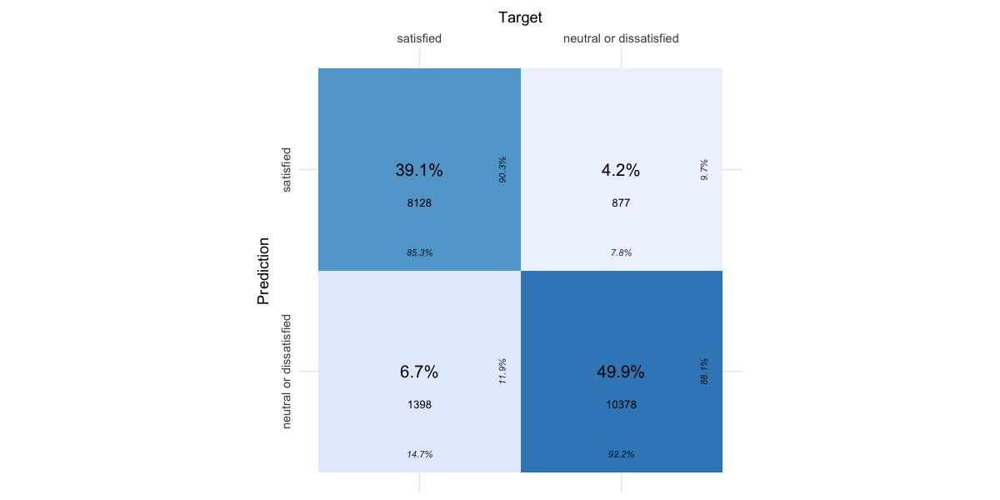

In [252]:
#visualizing the confusion matrix ...............
library("cvms")


nb_table_test = as_tibble(nb_confusion_matrix_test$table)
colnames(nb_table_test)=c('Target','Prediction','N')

options(repr.plot.width = 10, repr.plot.height = 5)
plot_confusion_matrix(nb_table_test)